# Digital Signal Proccesing on Audio Tracks

In [1]:
# !pip install seaborn --upgrade
# !pip freeze | grep seaborn
# import sys
# sys.path.append("/path/to/module")


In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import os

In [4]:
import matplotlib.style as style 

style.use('ggplot')
sns.set_context('notebook')
cmap = 'RdYlGn'
sns.set_palette(cmap)

In [5]:
import struct
from glob import glob
import librosa as lr
import librosa.display

In [6]:
from mpl_toolkits.mplot3d import axes3d
import IPython.display as ipd

%matplotlib inline

In [7]:
audio_path = 'clips_compiled.wav'

In [8]:
audio, sfreq = lr.load(audio_path)
time = np.arange(0, len(audio)) / sfreq
print(f'audio: {audio.shape}\ntime: {time.shape}\nsfreq: {sfreq}')

audio: (793800,)
time: (793800,)
sfreq: 22050


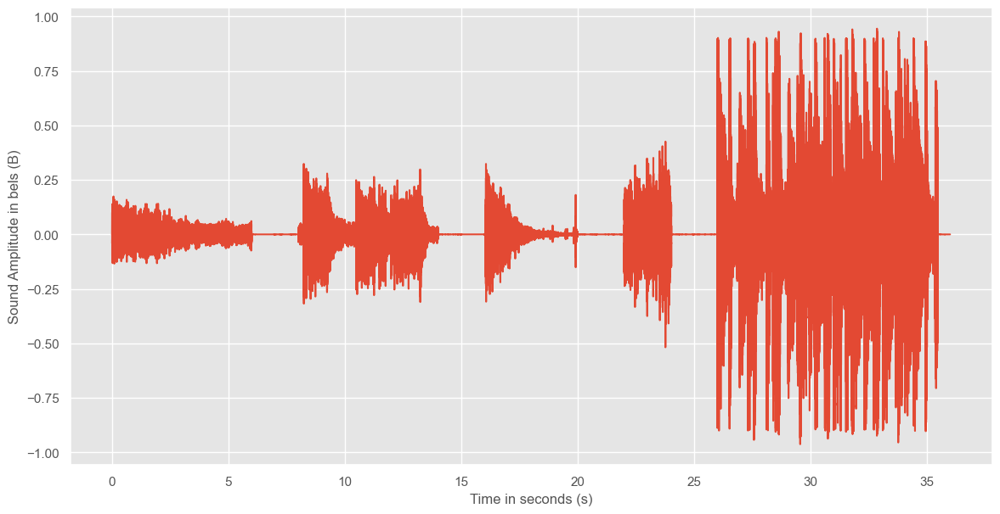

In [9]:
_, ax = plt.subplots(figsize=(14,7))
ax.plot(time, audio)
ax.set(xlabel='Time in seconds (s)', ylabel='Sound Amplitude in bels (B)')
plt.show()

In [10]:
ipd.Audio(audio_path)

In [ ]:
plt.figure(figsize=(14,7))
lr.display.waveshow(audio, sr=sfreq)
plt.ylabel('Amplitude (B)')

In [ ]:
#display Spectrogram
X = librosa.stft(audio)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sfreq, x_axis='s', y_axis='hz', cmap=cmap) 
#If to pring log of frequencies  
#librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.title('Spectrogram')
plt.colorbar()
plt.show()

In [ ]:
#display Spectrogram
X = librosa.stft(audio)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
# librosa.display.specshow(Xdb, sr=sfreq, x_axis='time', y_axis='hz', cmap=cmap) 
#If to pring log of frequencies  
librosa.display.specshow(Xdb, sr=sfreq, x_axis='time', y_axis='log', cmap=cmap)
plt.title('Logged Spectrogram')
plt.colorbar()
plt.show()

___
___
### Individual clip analysis

In [11]:
clips = [x for x in glob('./audio_files/*.wav')]

In [12]:
amp, sr = lr.load(clips[-1])

/Users/dom/Repos/DSP_Songs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  


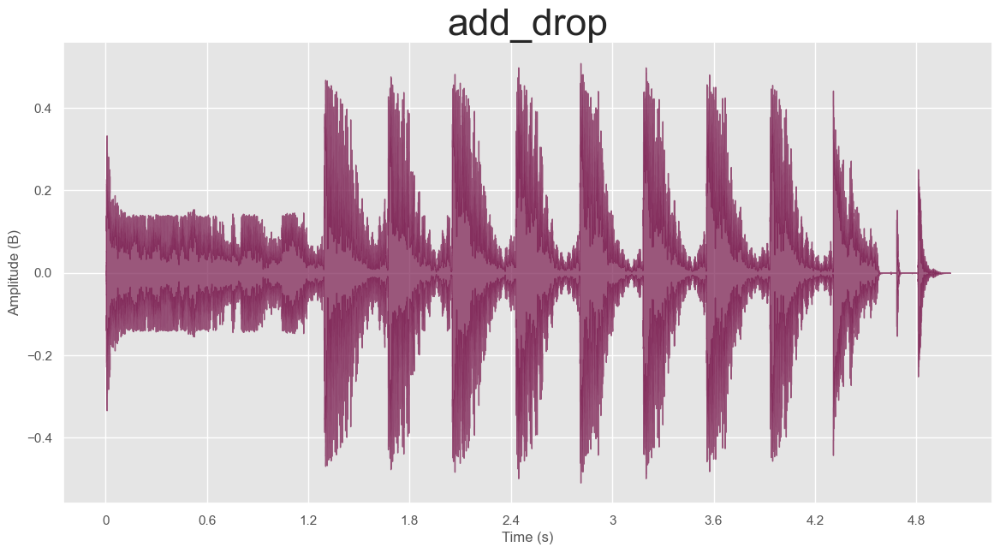

In [13]:
plt.figure(figsize=(14,7))
lr.display.waveshow(amp, sr=sr, alpha=0.7, color='#7a1b4f', x_axis='s')
plt.ylabel('Amplitude (B)')
plt.xlabel('Time (s)')
plt.title(clips[-1].split('/')[-1][:-4], fontsize=32)

ipd.Audio(clips[-1])

In [14]:
clips

['./audio_files/loyal_drum.wav',
 './audio_files/steele_pura_drum.wav',
 './audio_files/steele_pura_bells.wav',
 './audio_files/loyal_horn.wav',
 './audio_files/steele_pura_beat.wav',
 './audio_files/add_drop.wav']

/Users/dom/Repos/DSP_Songs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  


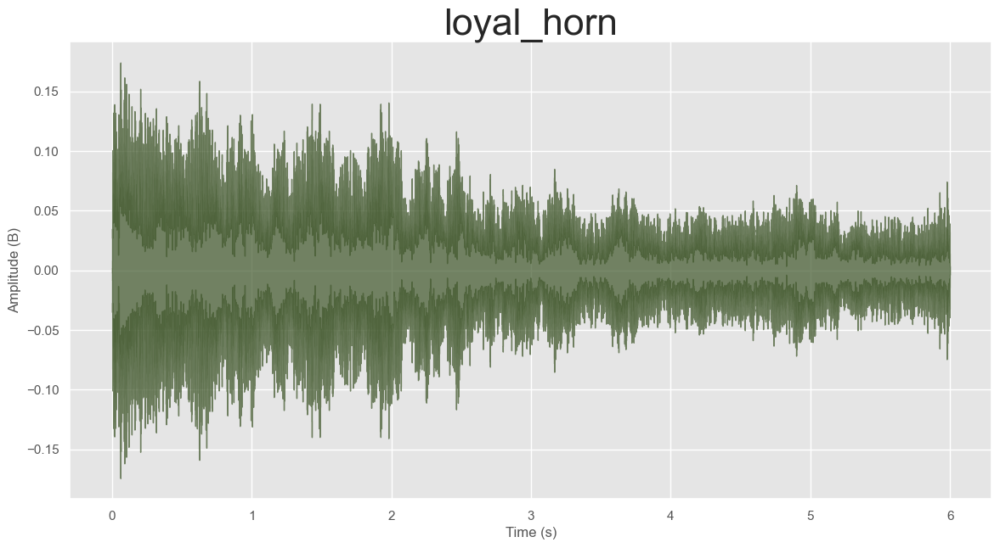

In [15]:
track = clips[3]

amp, sr = lr.load(track)

plt.figure(figsize=(14,7))
lr.display.waveshow(amp, sr=sr, alpha=0.7, color='#40572b', x_axis='s')
plt.ylabel('Amplitude (B)')
plt.xlabel('Time (s)')
plt.title(track.split('/')[-1][:-4], fontsize=32)

ipd.Audio(track)

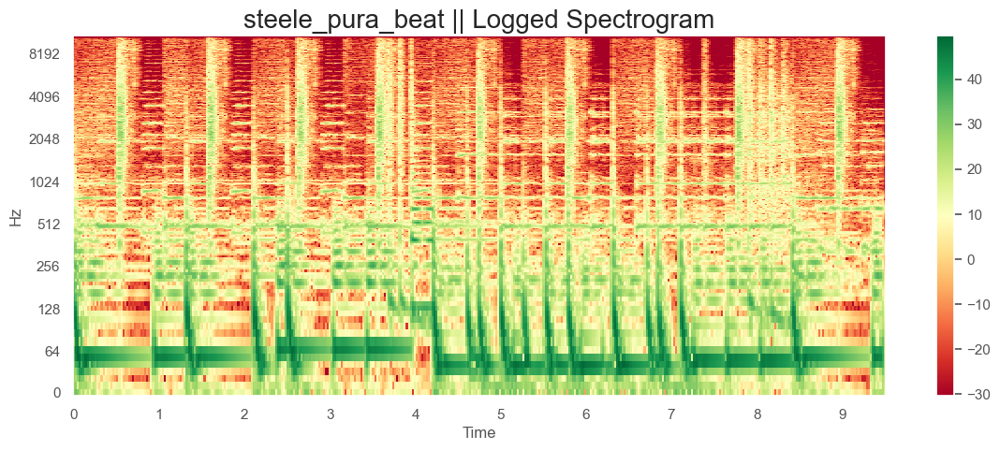

In [16]:
track = clips[-2]

amp, sr = lr.load(track)

#display Spectrogram
X = librosa.stft(amp)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
# librosa.display.specshow(Xdb, sr=sfreq, x_axis='time', y_axis='hz', cmap=cmap) 
#If to pring log of frequencies  
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log', cmap=cmap)
plt.title(track.split('/')[-1][:-4] + ' || Logged Spectrogram', fontsize=20)
plt.colorbar()
plt.show()

/Users/dom/Repos/DSP_Songs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:6: FutureWarning: waveshow() keyword argument 'x_axis' has been renamed to 'axis' in version 0.10.0.
	This alias will be removed in version 1.0.
  


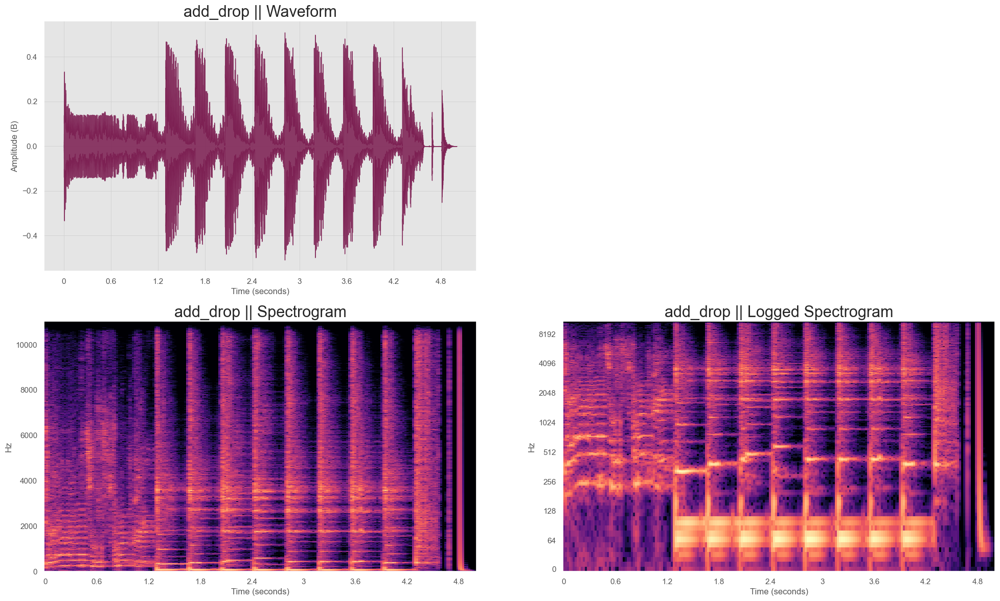

In [56]:
track = clips[-1]

amp, sr = lr.load(track)

_, ax = plt.subplots(nrows=2, ncols=2, figsize=(24,14))
lr.display.waveshow(amp, sr=sr, alpha=0.85, color='#7a1b4f', x_axis='s', ax=ax[0,0])
ax[0,0].set_ylabel('Amplitude (B)')
# ax1.set_xlabel('Time (s)')
ax[0,0].set_title(track.split('/')[-1][:-4] + ' || Waveform', fontsize=22)
ax[0,0].grid(linestyle='-', linewidth='0.5', color='#cccccc')


X = librosa.stft(amp)  # , n_fft=)
Xdb = librosa.amplitude_to_db(abs(X))

librosa.display.specshow(Xdb, sr=sr, x_axis='s', y_axis='hz', cmap='magma', ax=ax[1,0]) 
#If to pring log of frequencies  
ax[1,0].set_title(track.split('/')[-1][:-4] + ' || Spectrogram', fontsize=22)

# plt.colorbar()
ax[1,0].grid(linestyle='-', linewidth='0.5', color='#cccccc')

librosa.display.specshow(Xdb, sr=sr, x_axis='s', y_axis='log', cmap='magma', ax=ax[1,1])
ax[1,1].set_title(track.split('/')[-1][:-4] + ' || Logged Spectrogram', fontsize=22)

ax[0,1].set_visible(False)
ipd.Audio(track)

In [149]:
amp, sr = lr.load(clips[-1])

time = np.arange(0, len(track)) / sfreq
t_frames = lr.time_to_frames(time, sr=sr, hop_length=512, n_fft=2048)
t_frames = t_frames.reshape((-1, 1))

D = librosa.stft(amp)  # , n_fft=)
S = librosa.amplitude_to_db(abs(D))
# Dimensions of specrogram D - (f, t)
# t: frames_to_samples
# f: fft_frequencies
# np.abs(D[..., f, t]) is the magnitude of frequency bin f at frame t, and
# np.angle(D[..., f, t]) is the phase of frequency bin f at frame t

print(f'time:\t {time.shape}\nsr:\t\t {sr}\namp:\t {amp.shape}\n'
      f'amp spectropgram: {D.shape}\ndb spectropgram: {S.shape}\ntemporal frames: {t_frames.shape}')


time:	 (26,)
sr:		 22050
amp:	 (110250,)
amp spectropgram: (1025, 216)
db spectropgram: (1025, 216)
temporal frames: (26, 1)


In [150]:
S = np.swapaxes(np.swapaxes(S[:-1], 0, 1)[:-1], 0, 1)
ts = np.arange(0, S.shape[1])  # .reshape((1,-1))
freq = np.linspace(0, sr*S.shape[0], S.shape[0]).reshape((-1,1))

print(f'ts: {ts.shape}\nfreq: {freq.shape}')
np.broadcast_shapes(ts.shape, freq.shape, S.shape)

ts: (215,)
freq: (1024, 1)


(1024, 215)

In [168]:
import plotly.graph_objects as go

sh_0, sh_1 = S.shape
x, y = np.linspace(0, S.shape[0], S.shape[0]), np.linspace(0, sr*S.shape[0], S.shape[0])
fig = go.Figure(data=[go.Surface(z=S, x=x, y=y)])
fig.update_layout(title='Clip name - ADD drop', autosize=False,
                  scene ={            
                    "xaxis": {"nticks": 11, "title": "time"},
                    "yaxis": {"title": "frequency"},
                    "zaxis": {"nticks": 10},
                    'camera_eye': {"x": 0, "y": -1, "z": 1},
                    "aspectratio": {"x": 0.8, "y": 0.6, "z": 0.4}
                  },
                    # dict(
                    # xaxis_title='time',
                    # yaxis_title='Frequency (Hz)',
                    # zaxis_title='Magnitude (dB'),),
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()
ipd.Audio(clips[-1])

In [154]:
fig = go.Figure(data=[go.Surface(z=S)])
fig.update_traces(contours_z=dict(show=True, usecolormap=True,
                                  highlightcolor="limegreen", project_z=True))
fig.update_layout(title='Clip Name', autosize=False,
                  scene_camera_eye=dict(x=1.87, y=0.88, z=-0.64),
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90)
)
ipd.Audio(track)
fig.show()

In [171]:
from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=2,
                    specs=[[{'is_3d': True}, {'is_3d': True}]],
                    subplot_titles=['Color corresponds to z', 'Color corresponds to distance to origin'],
                    )

fig.add_trace(go.Surface(z=S, x=x, y=y, colorbar={'x': -0.07}), 1, 1)
fig.add_trace(go.Surface(x=x, y=y, z=S, surfacecolor=ts**2 + freq**2 + S**2), 1, 2)
fig.update_layout(title_text="Ring cyclide")
fig.show()

In [172]:
ty, tz = np.arange(0, sr/2), np.arange(0, sr/2)
x = np.vstack((ty, tz))
x = x.reshape((-1, 2))

In [173]:
(S**2).shape

(1024, 215)

In [24]:
ty, tz = np.arange(0, sr/2), np.arange(0, sr/2)
Xtime = np.arange(0, sr)
YHz = X[:-1]
ZdB = Xdb[:-1]
print(f'Xtime: {Xtime.shape}\nFrequency (Hz): {YHz.shape}\nAmplitude (decibels): {ZdB.shape}')
result = bool(sr/YHz.shape[0] and sr/ZdB.shape[1])
print(f'Lengths pass broadcasting: {result}')

Xtime: (22050,)
Frequency (Hz): (1024, 216)
Amplitude (decibels): (1024, 216)
Lengths pass broadcasting: True


In [25]:
YHz[:].shape

(1024, 216)

In [26]:
y = np.swapaxes(YHz, 0, 1)
y = y[:-1]
y = np.swapaxes(y, 0, 1)
y.shape

(1024, 215)

In [27]:
z = np.swapaxes(ZdB, 0, 1)
z = z[:-1]
z = np.swapaxes(z, 0, 1)
z.shape

(1024, 215)

In [28]:
Xdb[:-1].shape

(1024, 216)

In [29]:
# Xdb[0]
Xdb.shape
Z = np.reshape(X, (-1,))
Z.shape

(221400,)

In [30]:
lr.time_to_frames(Xdb[0], sr=sr).shape

(216,)

In [31]:

Z.shape

(221400,)

In [32]:
lr.time_to_frames(Xtime, sr=sr).shape

(22050,)

In [33]:
Xtime

array([    0,     1,     2, ..., 22047, 22048, 22049])

In [34]:
amp.reshape((-1, 1)).shape
time.reshape((-1, 1)).shape
# (amp.reshape((-1, 1)) + time.reshape((-1, 1)))
np.swapaxes(amp.reshape((-1, 10)), 0, 1).shape

(10, 11025)

In [35]:
time.reshape((-1, 1)).shape

(793800, 1)

In [42]:
# Zdb = librosa.amplitude_to_db(amp)
Zdb = librosa.amplitude_to_db(abs(Z))
Zdb.reshape((1025, 216))

array([[ -8.722195 , -10.546895 , -12.886707 , ..., -34.15191  ,
        -33.256424 , -34.940075 ],
       [-10.989571 ,  -9.405865 , -10.118655 , ..., -32.991344 ,
        -39.227047 , -39.227047 ],
       [-12.753205 , -12.285732 ,  -1.4831727, ..., -23.273504 ,
        -31.888851 , -39.13359  ],
       ...,
       [-39.227047 , -39.227047 , -39.227047 , ..., -39.227047 ,
        -39.227047 , -39.227047 ],
       [-39.227047 , -39.227047 , -39.227047 , ..., -39.227047 ,
        -39.227047 , -39.227047 ],
       [-39.227047 , -39.227047 , -39.227047 , ..., -39.227047 ,
        -39.227047 , -39.227047 ]], dtype=float32)

In [53]:
np.swapaxes(X[:-1], 0, 1)[:-1].reshape((-1)).shape

# Zdb.shape

(220160,)

In [38]:
from mpl_toolkits.mplot3d.axes3d import Axes3D

In [44]:
print(f'time: {time.shape}\namp: {amp.shape}\ndB: {X.reshape((-1)).shape}')

time: (793800,)
amp: (110250,)
dB: (221400,)


In [55]:
# 793800 / 220160  # 221400  # 110250
220160 / 110250

1.9969160997732427

In [ ]:
sr

In [ ]:
Xtime.reshape((2, -1)).shape

In [ ]:
ty, tz = np.arange(0, sr/2), np.arange(0, sr/2)
x = np.vstack((ty, tz))
x = np.swapaxes(x, 0, 1)
x.shape

In [ ]:
t0 = np.arange(0, sr/2)
for _ in range(19):
    tn = np.arange(0, sr/2)
    t0 = np.vstack((t0, tn))
t = np.swapaxes(t0, 0, 1)
t.shape

In [ ]:
print(f'X: {x.shape}\tY: {y.shape}\tZ: {z.shape}')

In [ ]:
Xx = np.arange(0, sr/2)
Xx = Xx.reshape((-1, 1))

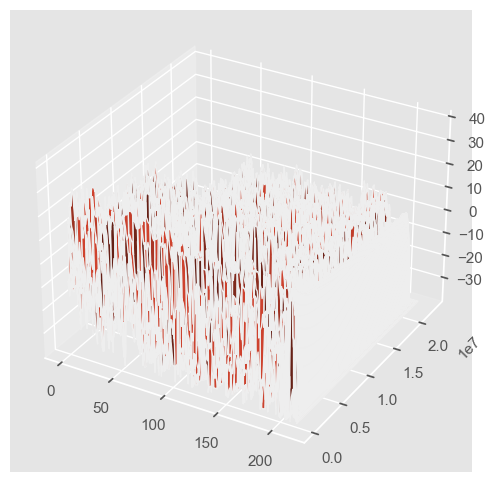

In [133]:
fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(1, 1, 1, projection='3d')
# Axes3D(0.05)
# ax.plot_surface(np.array(Xdb[0]), amp, np.array([Xdb[1], time[0]]), rstride=4, cstride=4)
# plt.plot3D(S, freq, ts)
ax.plot_surface(ts, freq, S, rstride=4, cstride=4)

plt.show()

In [ ]:
tmp = lr.fft_frequencies(sr=sr)
tmp.shape

In [ ]:
lr.amplitude_to_db(amp).shape